## Load the Fine Tuned model

Load dataset to observe predictions

In [1]:
from src.segmentation.framework_handlers.detectron2_handler import register_and_split_dataset

segments_dataset_name = "etaylor/stigmas_dataset"
release = "v0.2"

train_metadata, train_dataset_dicts, test_metadata, test_dataset_dicts = register_and_split_dataset(
    dataset_name=segments_dataset_name,
    release_version=release,
    train_ratio=0.8,  # 80% for training, 20% for testing
)

print(f"Train dataset: {len(train_dataset_dicts)} samples")
print(f"Test dataset: {len(test_dataset_dicts)} samples")

Initializing dataset...
Preloading all samples. This may take a while...


100%|██████████| 115/115 [00:00<00:00, 501.31it/s]


Initialized dataset with 115 images.
Exporting dataset. This may take a while...


100%|██████████| 115/115 [00:51<00:00,  2.23it/s]


Exported to ./export_coco-instance_etaylor_stigmas_dataset_v0.2.json. Images in segments/etaylor_stigmas_dataset/v0.2



Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.



Train dataset: 92 samples
Test dataset: 23 samples


In [2]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
import os
# When I want to load a fine tuned model
model_output_dir = '/home/etaylor/code_projects/thesis/checkpoints/stigmas_segmentation/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/15-12-2024_21-33-36'
model = "COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x"

# load the best model config and weights
checkpoint_path = os.path.join(model_output_dir, "model_final.pth")
config_yaml_path = os.path.join(model_output_dir, "config.yaml")
cfg = get_cfg()
# load config
cfg.merge_from_file(config_yaml_path)
# define predictor
# load checkpoint
cfg.MODEL.WEIGHTS = checkpoint_path
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.70   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

Loading config /home/etaylor/code_projects/thesis/checkpoints/stigmas_segmentation/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/15-12-2024_21-33-36/config.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


In [ ]:
import cv2
from matplotlib import pyplot as plt
from detectron2.utils.visualizer import Visualizer, ColorMode

def compare_predictions_and_annotations(dataset_dicts_test, metadata_test, predictor, num_samples=5, scale=0.5):
    """
    Compare model predictions with ground-truth annotations by plotting side-by-side.

    Args:
        dataset_dicts_test (list): Test dataset dictionary.
        metadata_test (Metadata): Metadata for the test dataset.
        predictor (DefaultPredictor): Trained model for making predictions.
        num_samples (int): Number of random samples to compare.
        scale (float): Scale for visualizer.
    """
    for i, d in enumerate(dataset_dicts_test[:num_samples]):
        # Load image and convert to RGB
        img = cv2.imread(d["file_name"])
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Ground truth annotations (in RGB)
        visualizer_gt = Visualizer(img_rgb, metadata=metadata_test, scale=scale)
        vis_gt = visualizer_gt.draw_dataset_dict(d)

        # Model predictions
        outputs = predictor(img_rgb)
        visualizer_pred = Visualizer(
            img_rgb,
            metadata=metadata_test,
            scale=scale,
            instance_mode=ColorMode.IMAGE  # Remove colors for unannotated parts
        )
        vis_pred = visualizer_pred.draw_instance_predictions(outputs["instances"].to("cpu"))

        # Plot side-by-side
        fig, axes = plt.subplots(1, 3, figsize=(20, 8))

        # Original image (in RGB)
        axes[0].imshow(img_rgb)
        axes[0].set_title("Original Image (RGB)")
        axes[0].axis("off")

        # Ground truth (already in RGB)
        axes[1].imshow(vis_gt.get_image())
        axes[1].set_title("Ground Truth Annotations")
        axes[1].axis("off")

        # Predictions (already in RGB)
        axes[2].imshow(vis_pred.get_image())
        axes[2].set_title("Model Predictions")
        axes[2].axis("off")

        plt.tight_layout()
        plt.show()


/home/etaylor/.conda/envs/detectron_fastai/lib/python3.9/site-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


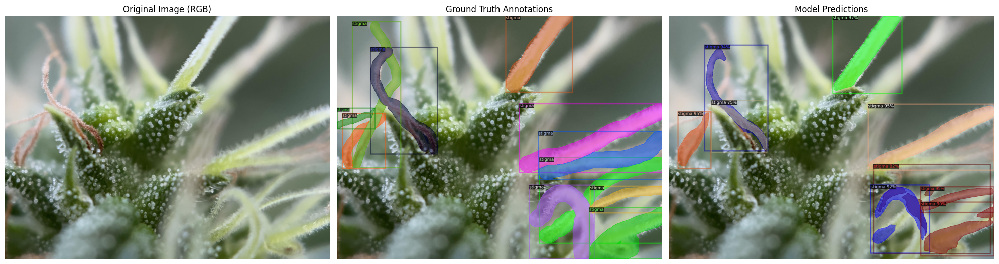

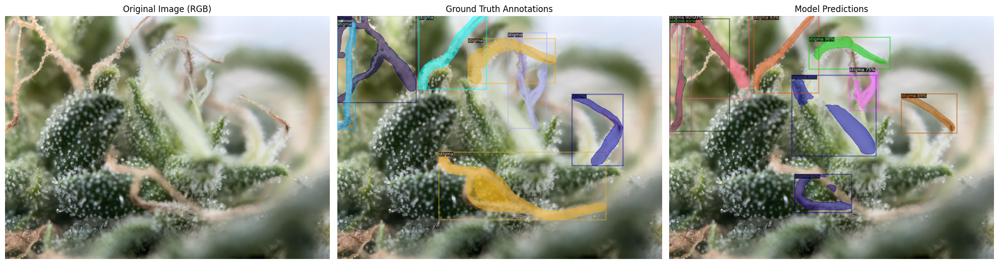

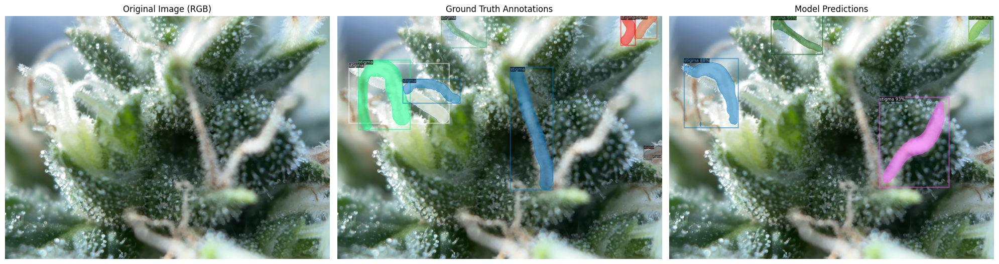

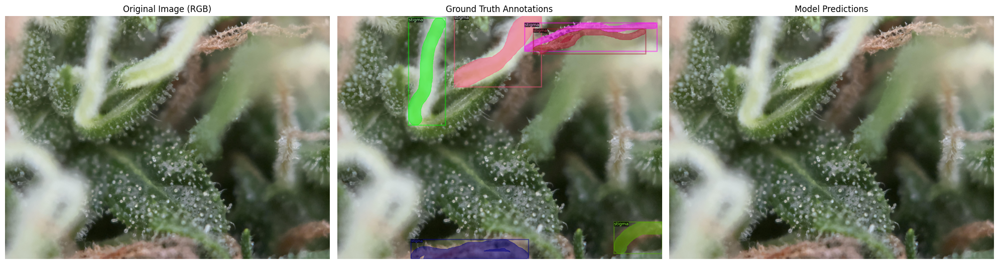

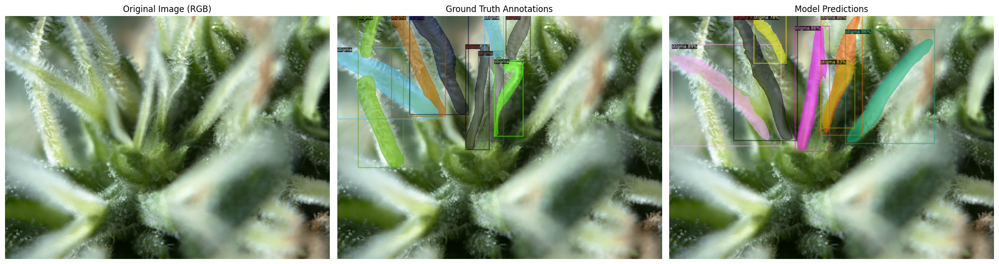

...

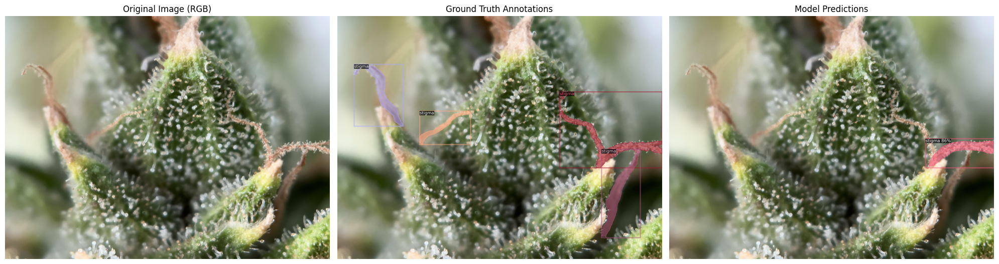

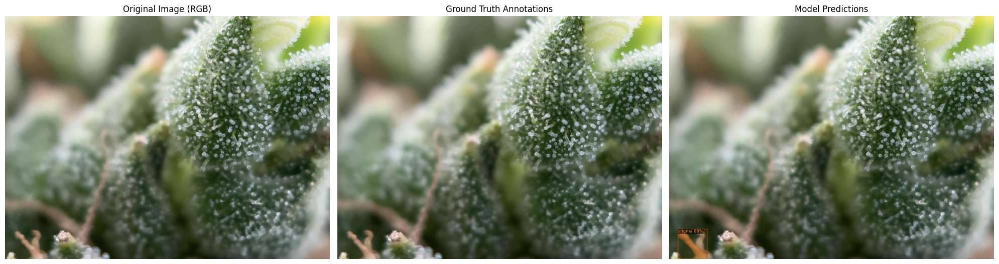

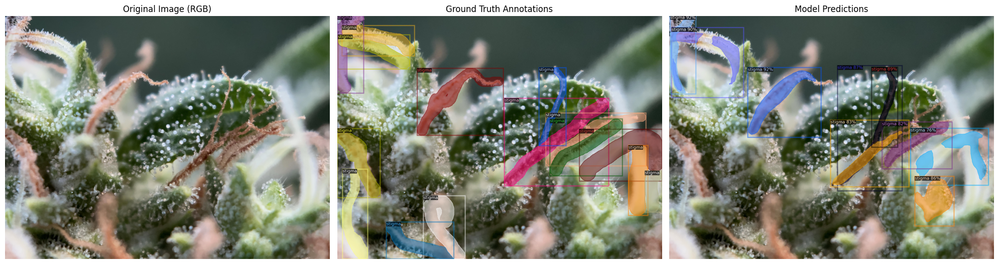

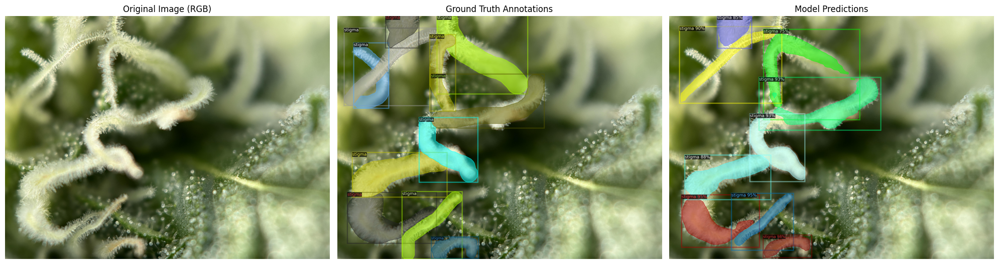

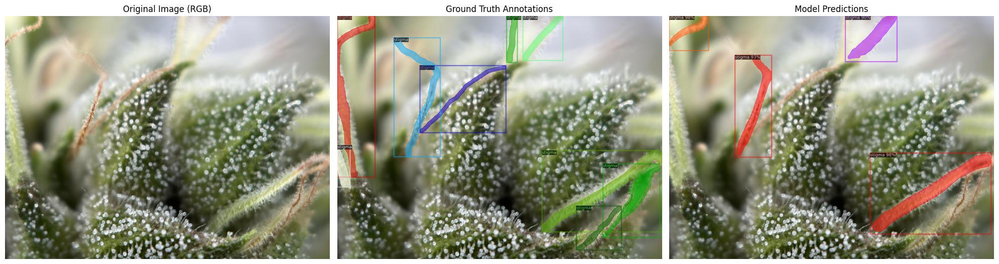

In [6]:
# Compare predictions and annotations for 5 test images
compare_predictions_and_annotations(
    dataset_dicts_test=test_dataset_dicts,
    metadata_test=test_metadata,
    predictor=predictor,
    num_samples=20,
    scale=0.8
)

In [7]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from detectron2.utils.visualizer import Visualizer, ColorMode
import os

# Calculate the color ratio of stigmas (only orange and white)
def calculate_stigma_color_distribution(img_rgb, outputs):
    instances = outputs["instances"].to("cpu")
    masks = instances.pred_masks
    num_stigmas = len(masks)

    if num_stigmas == 0:
        return {"orange_ratio": 0, "white_ratio": 0}

    img_hsv = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2HSV)

    orange_lower = np.array([5, 100, 100])
    orange_upper = np.array([20, 255, 255])
    white_lower = np.array([0, 0, 200])
    white_upper = np.array([180, 40, 255])

    orange_count = white_count = 0

    for mask in masks:
        mask = mask.numpy().astype(np.uint8)
        segmented_region = cv2.bitwise_and(img_hsv, img_hsv, mask=mask)

        orange_count += np.sum(cv2.inRange(segmented_region, orange_lower, orange_upper) > 0)
        white_count += np.sum(cv2.inRange(segmented_region, white_lower, white_upper) > 0)

    total_pixels = orange_count + white_count
    return {
        "num_stigmas": num_stigmas,
        "orange_ratio": orange_count / total_pixels if total_pixels > 0 else 0,
        "white_ratio": white_count / total_pixels if total_pixels > 0 else 0,
    }

# Process and visualize full images
def analyze_full_stigmas_images(dataset_dicts, metadata, predictor, num_samples=5):
    for i, d in enumerate(dataset_dicts[:num_samples]):
        img = cv2.imread(d["file_name"])
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        outputs = predictor(img_rgb)
        ratio = calculate_stigma_color_distribution(img_rgb, outputs)
        print(f"Sample {i+1} - Orange: {ratio['orange_ratio']:.2f}, White: {ratio['white_ratio']:.2f}")

        visualizer = Visualizer(img_rgb, metadata=metadata, scale=0.5)
        vis = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))

        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(img_rgb)
        axes[0].set_title("Original Image")
        axes[0].axis("off")
        axes[1].imshow(vis.get_image())
        axes[1].set_title("Segmented Image (Stigma Analysis)")
        axes[1].axis("off")

        plt.tight_layout()
        plt.show()

        segmented_stigmas = extract_stigma_segments(img_rgb, outputs)
        visualize_extracted_stigmas(segmented_stigmas)

        classify_stigma_by_color(ratio)

# Visualize extracted stigmas separately
def visualize_extracted_stigmas(segmented_stigmas):
    if not segmented_stigmas:
        print("No stigmas to display.")
        return

    fig, axes = plt.subplots(1, len(segmented_stigmas), figsize=(16, 8))
    for idx, stigma in enumerate(segmented_stigmas):
        axes[idx].imshow(stigma)
        axes[idx].set_title(f"Stigma {idx + 1}")
        axes[idx].axis("off")

    plt.tight_layout()
    plt.show()

# Extract segmented stigmas and optionally save them
def extract_stigma_segments(img_rgb, outputs, save_dir=None):
    instances = outputs["instances"].to("cpu")
    masks = instances.pred_masks
    boxes = instances.pred_boxes.tensor.numpy()

    if len(masks) == 0:
        print("No stigmas detected.")
        return []

    extracted_segments = []

    if save_dir:
        os.makedirs(save_dir, exist_ok=True)

    for i, mask in enumerate(masks):
        mask = mask.numpy().astype(np.uint8)
        x_min, y_min, x_max, y_max = boxes[i].astype(int)
        stigma_segment = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)
        cropped_stigma = stigma_segment[y_min:y_max, x_min:x_max]
        extracted_segments.append(cropped_stigma)

        if save_dir:
            stigma_filename = f"stigma_{i + 1}.png"
            save_path = os.path.join(save_dir, stigma_filename)
            cv2.imwrite(save_path, cv2.cvtColor(cropped_stigma, cv2.COLOR_RGB2BGR))
            print(f"Saved: {save_path}")

    return extracted_segments

# Classify stigmas based on the calculated color ratios
def classify_stigma_by_color(ratio):
    orange_ratio = ratio['orange_ratio']
    white_ratio = ratio['white_ratio']

    if orange_ratio > 0.5:
        stigma_class = "Dominantly Orange"
    elif white_ratio > 0.5:
        stigma_class = "Dominantly White"
    else:
        stigma_class = "Mixed"

    print(f"Classified Stigma: {stigma_class}")


Sample 1 - Orange: 0.07, White: 0.93


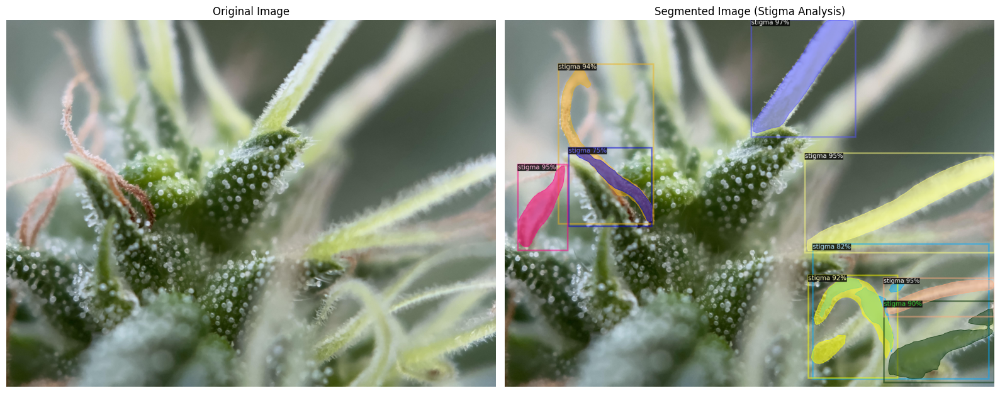

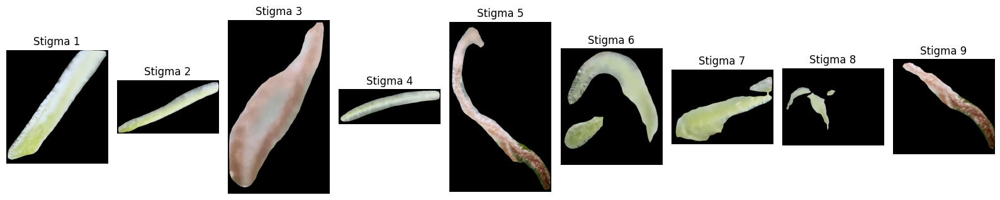

Classified Stigma: Dominantly White
Sample 2 - Orange: 0.07, White: 0.93


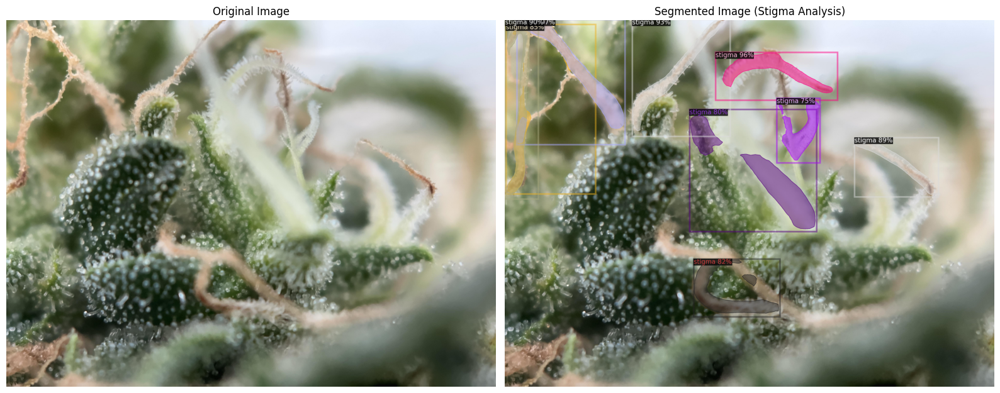

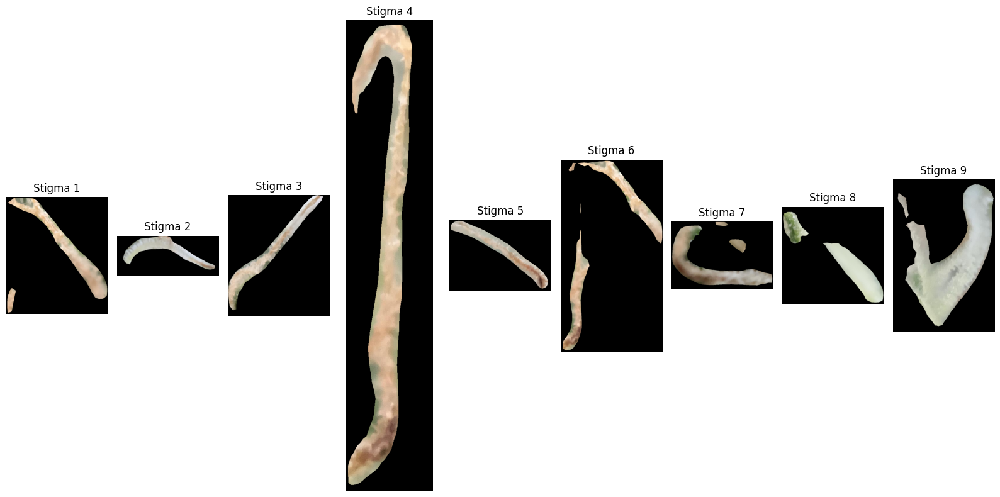

Classified Stigma: Dominantly White
Sample 3 - Orange: 0.00, White: 1.00


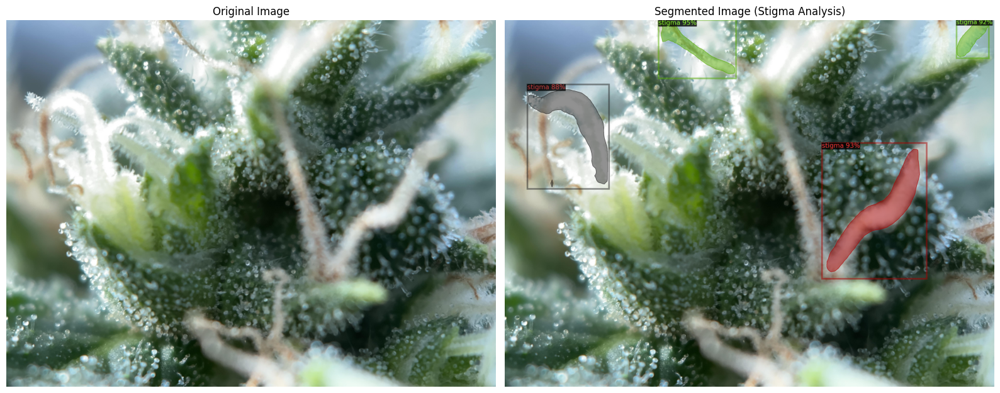

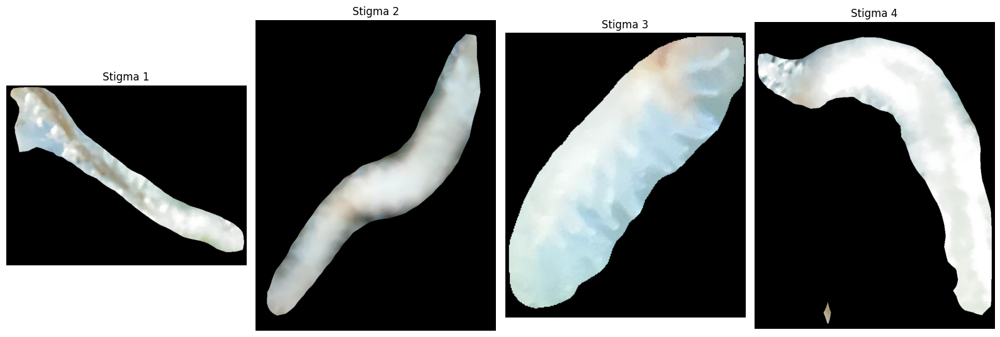

Classified Stigma: Dominantly White


In [8]:
analyze_full_stigmas_images(
    dataset_dicts=test_dataset_dicts,
    metadata=test_metadata,
    predictor=predictor,
    num_samples=3,
)

## Evaluate the Model

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset, DatasetEvaluator
from detectron2.data import build_detection_test_loader
import json

evaluator = COCOEvaluator(dataset_name_test, output_dir=os.path.join(cfg.OUTPUT_DIR, dataset_name_test))
val_loader = build_detection_test_loader(cfg, dataset_name_test)
eval_results = inference_on_dataset(predictor.model, val_loader, evaluator)

# Check if the directory exists
output_dir = os.path.join(cfg.OUTPUT_DIR, os.path.basename(dataset_name_test))
if not os.path.exists(output_dir):
    os.mkdir(output_dir)
    
eval_results_saving_path = os.path.join(cfg.OUTPUT_DIR, os.path.basename(dataset_name_test), "evaluation_results.json")
# Save the eval_results dictionary to a JSON file
with open(eval_results_saving_path, 'w') as file:
    json.dump(eval_results, file, indent=4)